1.numpyを使った行列の四則演算

In [4]:
import numpy as np
A=np.array([[2.0,1.0],[1.5,1.3]])
B=np.array([[4.0,3.0],[8.0,1.0]])
c=2

In [5]:
print("A+B=\n{}".format(A+B))
print("A-B=\n{}".format(A-B))
print("A*B=\n{}".format(A*B))
print("A*c=\n{}".format(A*c))
print("A@B=\n{}".format(A@B))

A+B=
[[6.  4. ]
 [9.5 2.3]]
A-B=
[[-2.  -2. ]
 [-6.5  0.3]]
A*B=
[[ 8.   3. ]
 [12.   1.3]]
A*c=
[[4.  2. ]
 [3.  2.6]]
A@B=
[[16.   7. ]
 [16.4  5.8]]


2.画像の表示、拡大縮小、回転、二値化

2.1 画像の表示

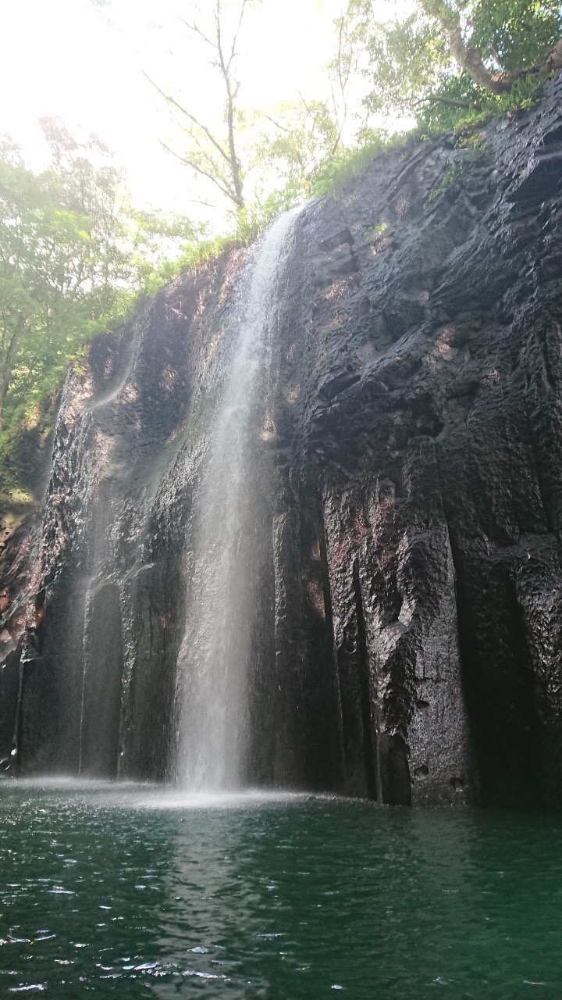

(1280, 720)

In [6]:
import cv2
from IPython.display import Image, display

def imshow(img):
    '''画像を Notebook 上にインラインで表示する。
    '''
    img = cv2.imencode('.png', img)[1]
    display(Image(img))
img = cv2.imread('IMG_7562.jpg')
imshow(img)
img.shape[:2]

2.2 画像の拡大

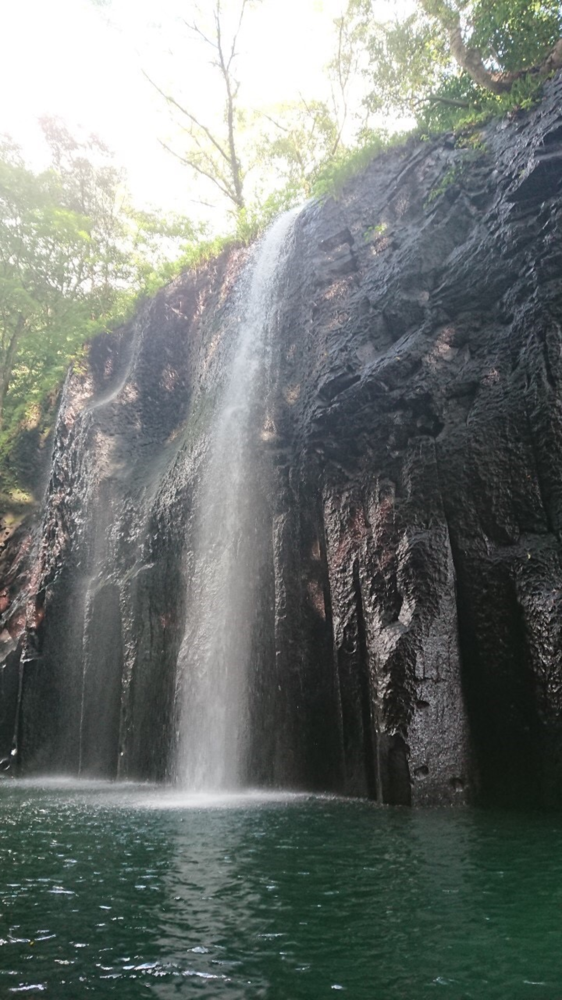

(2560, 1440)

In [7]:
height,width=img.shape[:2]
img_double=cv2.resize(img,(width*2,height*2))
imshow(img_double)
img_double.shape[:2]

2.3 画像の縮小

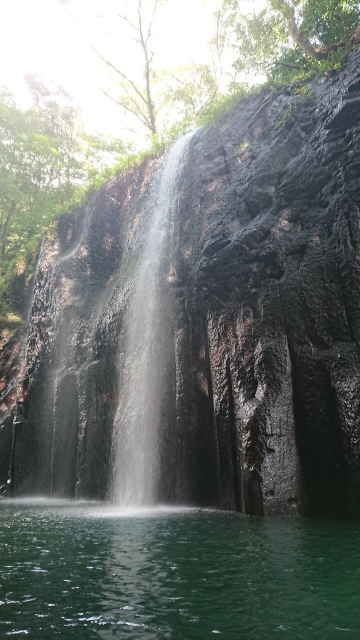

(640, 360)

In [8]:
height,width=img.shape[:2]
img_half=cv2.resize(img,(int(width/2),int(height/2)))
imshow(img_half)
img_half.shape[:2]

2.3 画像の回転

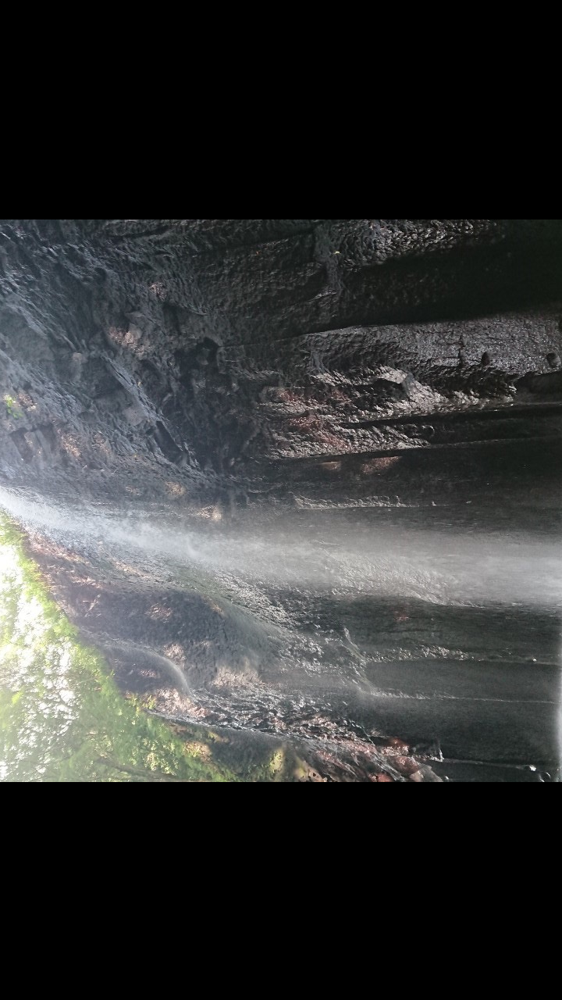

(1280, 720)

In [9]:
#回転の中心を定義
center=(int(width/2),int(height/2))
#回転角を指定
angle = 90.0
#スケールを指定
scale = 1.0
#getRotationMatrix2D関数を使用
trans = cv2.getRotationMatrix2D(center,angle,scale)
#アフィン変換
image_ro = cv2.warpAffine(img, trans, (width,height))
imshow(image_ro)
image_ro.shape[:2]

2.4 画像の二値化

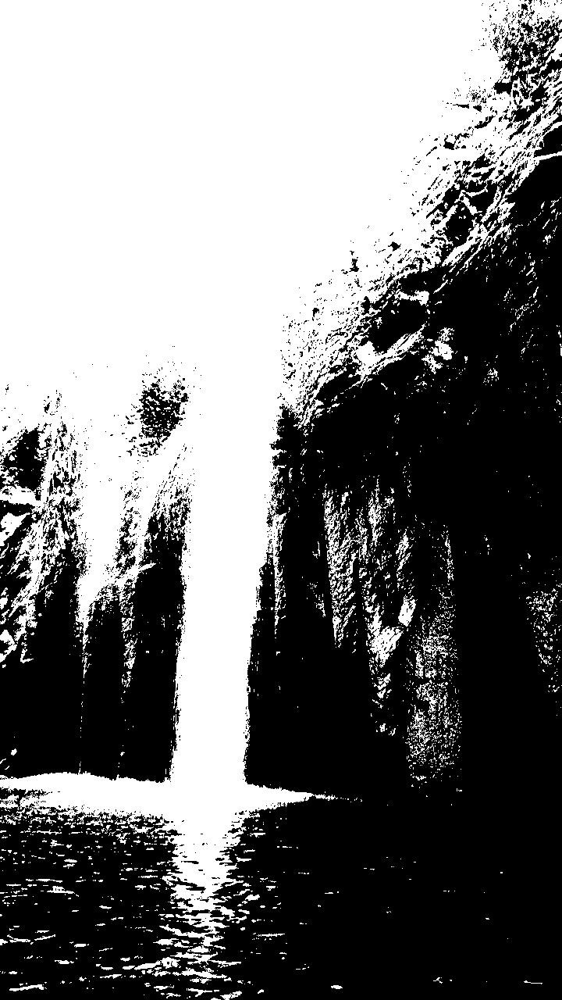

In [10]:
img_gray=cv2.imread("IMG_7562.JPG",0)

# 閾値の設定
threshold = 100

# 二値化(閾値100を超えた画素を255にする。)
ret, img_thresh = cv2.threshold(img_gray, threshold, 255, cv2.THRESH_BINARY)

# 二値化画像の表示
imshow(img_thresh)

3.差分画像作成

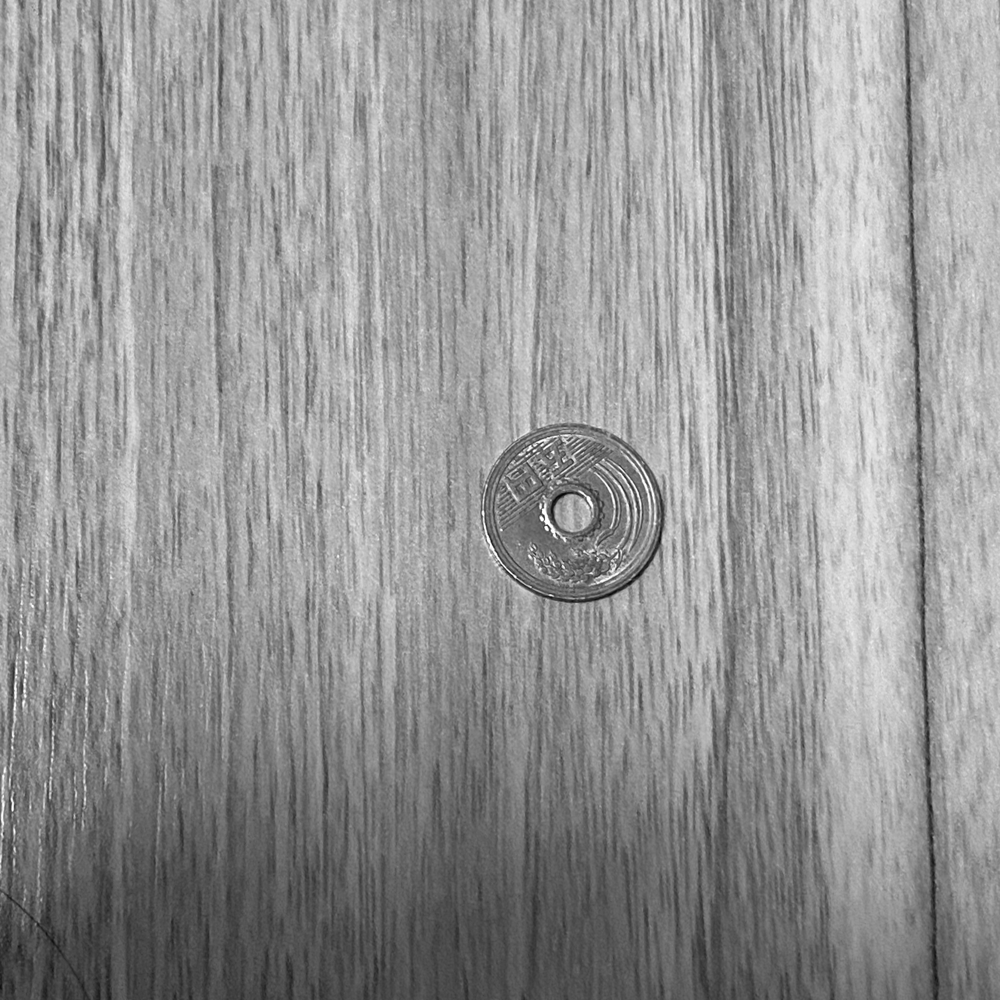

In [11]:
#「背景」となる画像の取り込み（グレースケール）
img_src01 = cv2.imread("sample01.jpg", 0)
imshow(img_src01)

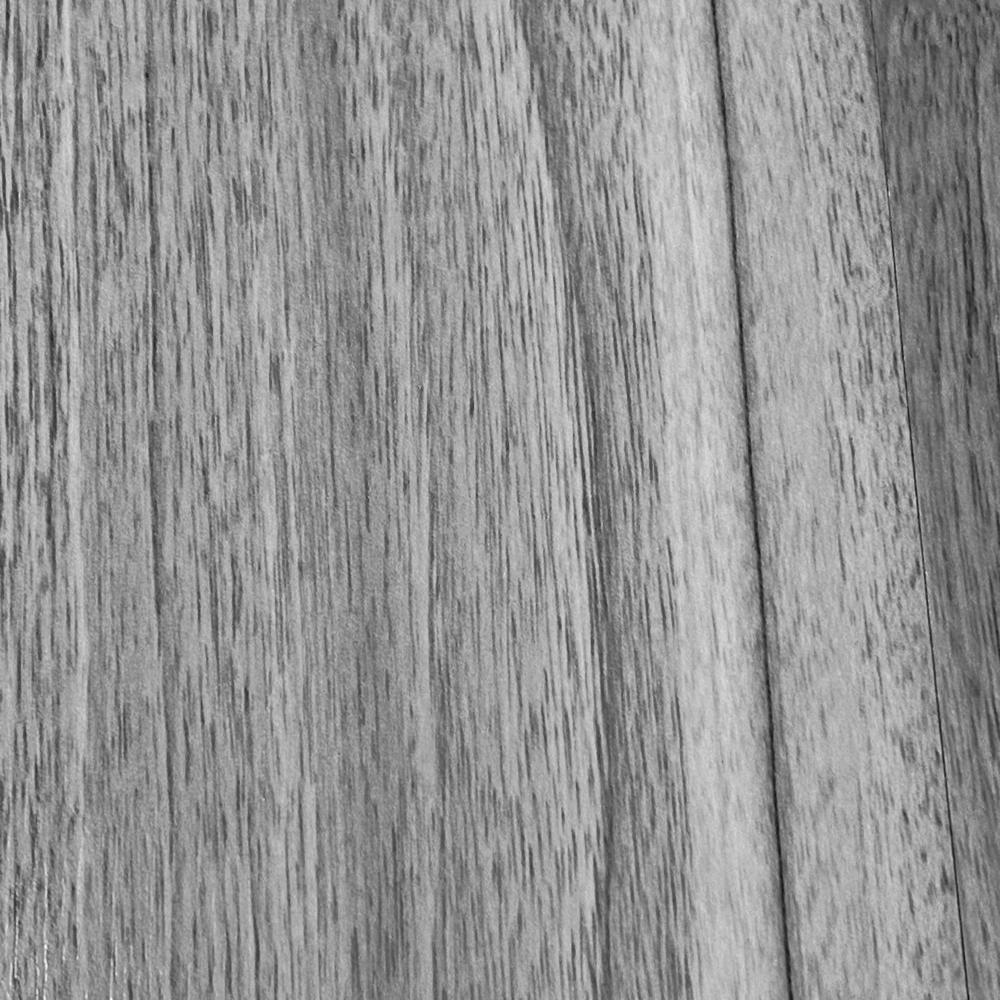

In [12]:
#「差分」をもった画像の取り込み（グレースケール）
img_src02 = cv2.imread("sample02.jpg", 0)
imshow(img_src02)

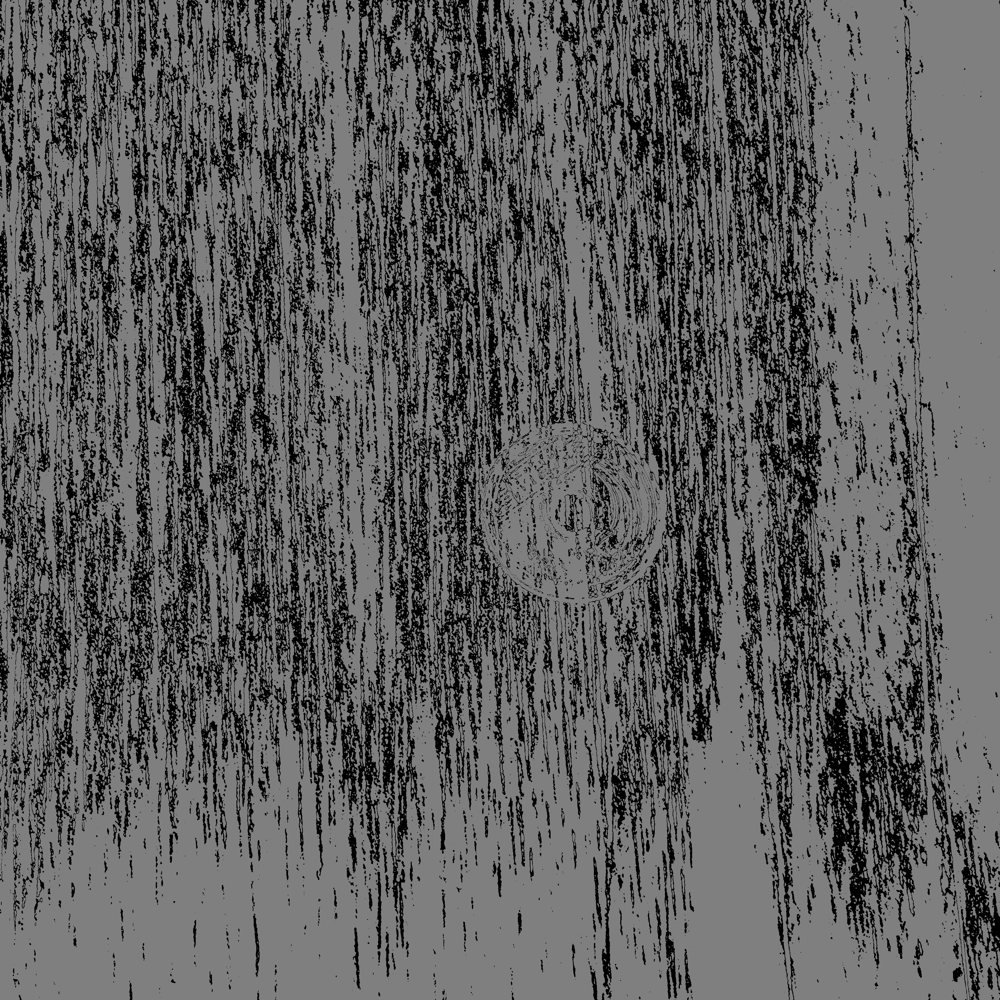

True

In [13]:
#「背景差分」計算用オブジェクトの作成　
bgObj = cv2.createBackgroundSubtractorMOG2()

#差分となっている「前景領域」に対してマスクをかける
fgmask = bgObj.apply(img_src01)
fgmask = bgObj.apply(img_src02)

#画面に表示
imshow(fgmask)

#「差分」画像のファイル名
bg_diff_path = "./diff.jpg"

#「差分」画像の保存
cv2.imwrite(bg_diff_path, fgmask)